# Introduction

In this assignment you will practice calibrating a camera, computing homography between images and stitching panoramas. The goals of this assignment are as follows:



*   Understand the intrinsic parameters of a prospective camera.
*   Understand feature detection and feature matching process.
*   Find the intrinsic and extrinsic parameters of a camera using chessboard patterns.
*   Compute homography between two images.
*   Use homography to stitch panoramas.

Please fill in all the **TODO** blocks (including codes and texts). Most of the assignment can be done by calling functions in OpenCV. However, if you try to implement those functions by yourself, you will get extra points (up to 20 pts). Once you are ready to submit:

* Export the notebook `CSCI677_assignment_2.ipynb` as a PDF `[Your USC ID]_CSCI677_assignment_2.pdf`
* Submit your PDF file through [Blackboard](https://blackboard.usc.edu/)

Please make sure that the notebook have been run before exporting PDF, and your code and all cell outputs are visible in your submitted PDF. Regrading request will not be accepted if your code/output is not visible in the original submission. Thank you!

# Data Unzip
We provided data for each of the section below. To acquire and unzip the data in Google Colab, first copy the file `data.zip` from [link](https://drive.google.com/file/d/1Dkd1fIvu0ckkhMgX1JaTnAb52mTiuMvM/view?usp=sharing) to your own Google Drive, and then run the following code. If `data.zip` is not in the root folder of your Google Drive, you need to change `zip_file_path`.

If you are completing the assignment on your own PC (not using Google Colab), then simply download `data.zip` from the [link](https://drive.google.com/file/d/1Dkd1fIvu0ckkhMgX1JaTnAb52mTiuMvM/view?usp=sharing) and extract to a location you prefer.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import zipfile

# Path to the zip file on your Google Drive
zip_file_path = '/content/drive/My Drive/data.zip'

# Destination folder where you want to extract the zip file
destination_folder = '/content/data'

# Unzipping the zip file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(destination_folder)

print(f'Contents of {zip_file_path} have been extracted to {destination_folder}')


# Calibration (35 pts)


## Data Preparation

To find out the intrinsic parameters of a camera, we need to prepare sample images of a chessboard pattern. This is done by taking photos of printed chessboard patterns or of chessboard patterns displayed on a flat screen. To achieve better accuracy, we need at least 10 of them from different angles. We provided sample images in the folder `calibration`, but we encourage you to try with your own camera or smartphone. You might find the following website useful for generating chessboard patterns of your preferred size:
https://markhedleyjones.com/projects/calibration-checkerboard-collection

Please make sure that every photo you take covers the entire chessboard.

## Pattern Recognition (10 pts)

To locate the chessboard pattern in the photos, you can use cv.findChessboardCorners(). You can refer to the code in
https://docs.opencv.org/4.8.0/dc/dbb/tutorial_py_calibration.html

Remember to change the sizes based on your own chessboard size. After you locate the corners, display one image with the chessboard pattern drawn on it.

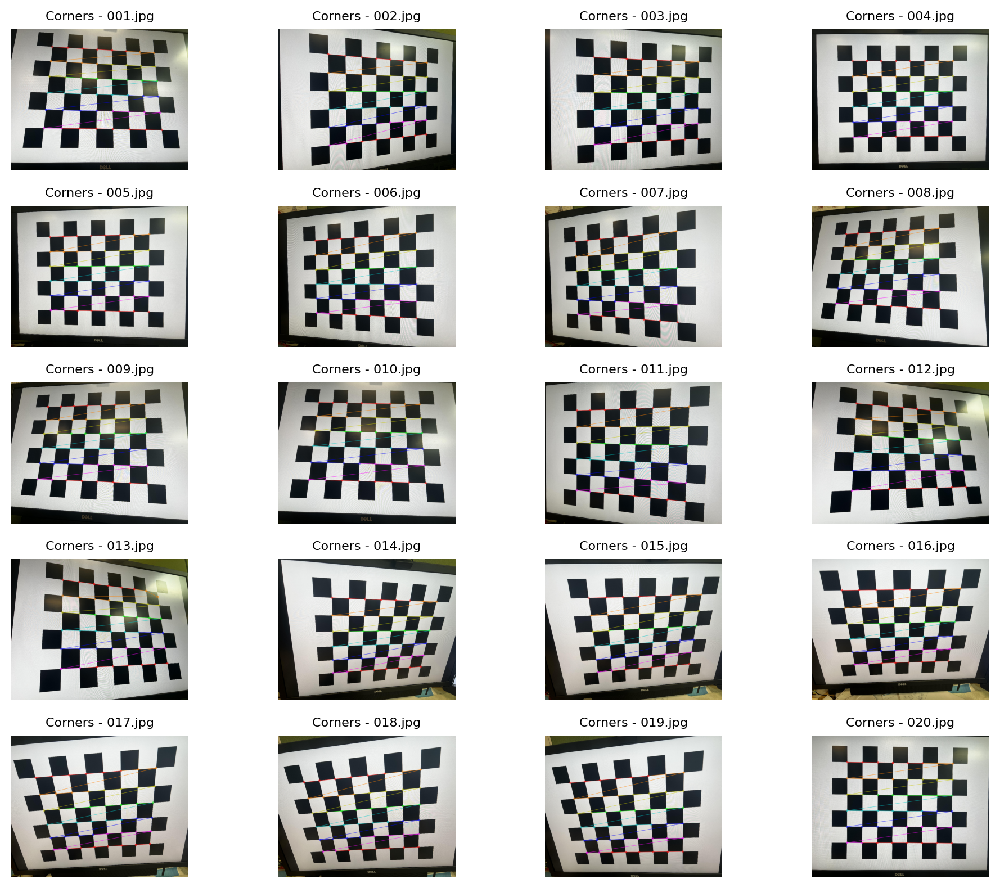

In [12]:
import numpy as np
import cv2 as cv
import glob
import os

images = glob.glob('data/calibration/*.jpg')

# TODO
# termination criteria
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)
import matplotlib.pyplot as plt
images.sort(key=lambda x: int(os.path.splitext(os.path.basename(x))[0]))

# dimensions of the chessboard corners.
rows, cols = 6, 8
plt.figure(figsize=(10, 8), dpi=200)

# object points
objp = np.zeros((6*8, 3), np.float32)
objp[:, :2] = np.mgrid[0:8, 0:6].T.reshape(-1, 2)

# arrays to store object points and image points from all the images.
objpoints = [] # 3d in real world space
imgpoints = [] # 2d in image plane.

for idx, fname in enumerate(images, start=1):
    # print(f'Processing {fname}...')
    img = cv.imread(fname)
    img = cv.resize(img, (1000, 800)) # resize for better visualization
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    
    # chessboard corners
    ret, corners = cv.findChessboardCorners(gray, (cols, rows), None)
    
    if ret == True:
        objpoints.append(objp)
        corners2 = cv.cornerSubPix(gray, corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners2)

        # draw the corners 
        cv.drawChessboardCorners(img, (rows, cols), corners2, ret)
    else:
        print(f'No corners detected in {fname}')
        
    # visualization
    img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)
    plt.subplot(5, 4, idx)
    plt.imshow(img_rgb)
    plt.title(f'Corners - {os.path.basename(fname)}', fontsize=8)
    plt.axis('off')  # to hide axis values

plt.tight_layout()
plt.show()

## Calibration (10 pts)

Now you are ready to calibrate the camera. You can use the function cv.calibrateCamera(), but you will get extra points (+5 pts) if you implement it by yourself.

After calibration, print the intrinsic parameters.

In [4]:
# TODO
ret, mtx, dist, rvecs, tvecs = cv.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

# Print the intrinsic parameters (camera matrix)
print("The intrinsic matrix (camera matrix) is:\n", mtx)
print("The distortion coefficients is:\n", dist)

The intrinsic matrix (camera matrix) is:
 [[3.07333614e+03 0.00000000e+00 2.02142832e+03]
 [0.00000000e+00 3.07579426e+03 1.53323847e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
The distortion coefficients is:
 [[ 2.84419811e-01 -1.48646839e+00  1.18471032e-04 -1.63026924e-04
   2.60040411e+00]]


## Pose Estimation (10 pts)

After you got the camera parameters, you can utilize the information to calculate the pose of a chessboard in a pattern image and display cool things. Follow the tutorial in
https://docs.opencv.org/4.8.0/d7/d53/tutorial_py_pose.html

Choose one of the following three to display:

* Render three axes on the chessboard image
* Render a cube on the chessboard image
* Render something you find cool (more complicated than three axes or a cube)

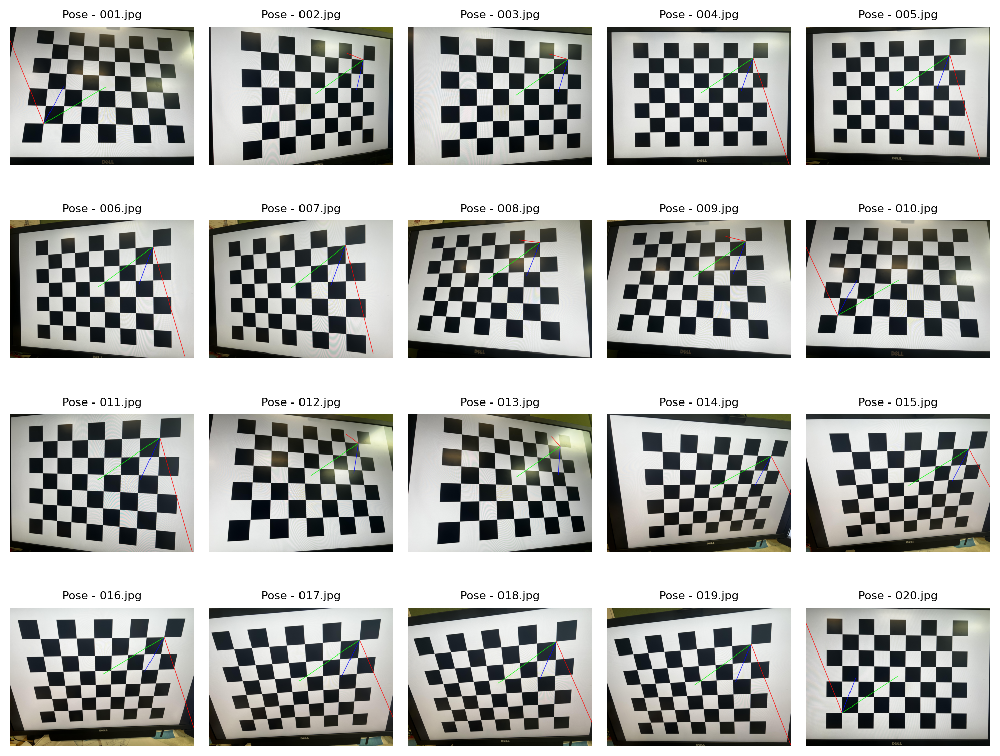

In [13]:
# TODO
def draw_axes(img, corners, imgpoints):
    # use int to convert
    corner = tuple(map(int, corners[0].ravel()))
    img = cv.line(img, corner, tuple(map(int, imgpoints[0].ravel())), (255, 0, 0), 10)
    img = cv.line(img, corner, tuple(map(int, imgpoints[1].ravel())), (0, 255, 0), 10)
    img = cv.line(img, corner, tuple(map(int, imgpoints[2].ravel())), (0, 0, 255), 10)
    return img

# initialize the axes
axis = np.float32([[3, 0, 0], [0, 3, 0], [0, 0, -3]]).reshape(-1,3)
plt.figure(figsize=(10, 8), dpi=200)

for idx, fname in enumerate(images, start=1):
    # print(f'Processing {fname}...')
    img = cv.imread(fname)
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    ret, corners = cv.findChessboardCorners(gray, (rows, cols), None)
    if ret == True:
        corners2 = cv.cornerSubPix(gray, corners, (11,11), (-1,-1), criteria)
        # find the rotation and translation vectors.
        ret, rvecs, tvecs = cv.solvePnP(objp, corners2, mtx, dist)
        # project 3D points to image plane
        imgpts, jac = cv.projectPoints(axis, rvecs, tvecs, mtx, dist)
        img = draw_axes(img, corners2, imgpts)
    else:
        print(f'No corners detected in {fname}')

    # visualization
    img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)

    plt.subplot(4, 5, idx)
    plt.imshow(img_rgb)
    plt.title(f'Pose - {os.path.basename(fname)}', fontsize=8)
    plt.axis('off')

plt.tight_layout()
plt.show()

## Observation (5 pts)
Write down your observations regarding the results you obtained throughout the `Calibration` section.

## **TODO: write down your observations**

The accuracy of function `cv.findChessboardCorners` could vary based on the images we give. It's important that the chessboard be captured at different angles and orientations. 

Use `cv.calibrateCamera` to calculate the camera matrix. The focal lengths can tell the zoom level of the camera, while the principal point provides information about the image's center of distortion. The radial and tangential distortion coefficients obtained can help understand how images get distorted by the camera.

Then, I use `cv.solvePnP` and `cv.projectPoints` to reproject the 3D chessboard corners back onto the image to calculate the reprojection error. The error measures the average distance between the actual 2D image points and the ones obtained by projecting the 3D points. A lower reprojection error indicates a successful calibration.

# Homography (35 pts)

## Data Preparation

To compute homography, you need to prepare one photo of an object (e.g. a book) and one photo of the same object in a different scene. We provided an example in the folder `homography`, but we encourage you to take photos with your own camera or smartphone.

## Feature Detection (10 pts)

After you have the two photos, load them using cv.imread(). Convert them to grayscale images. Create a SIFT feature detector. Detect the keypoints on both images and display them with size and orientation. You can follow the tutorial in https://docs.opencv.org/4.8.0/da/df5/tutorial_py_sift_intro.html

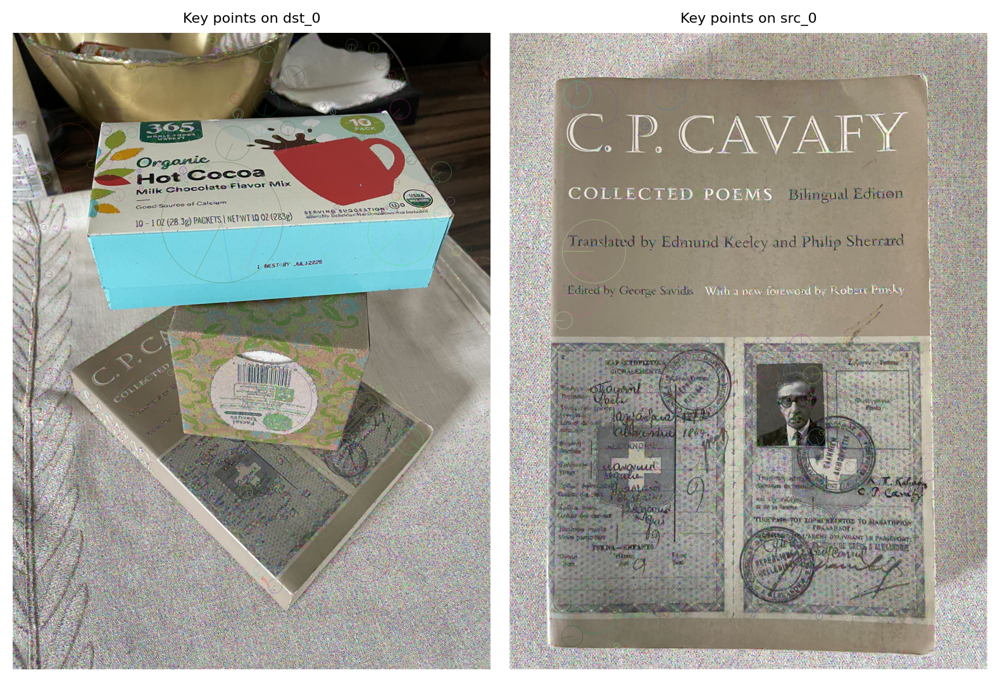

In [18]:
# TODO
# load the images, use src_0 -> dst_0 as an example
dst_img = cv.imread('data/homography/dst_0.jpg')
src_img = cv.imread('data/homography/src_0.jpg')

# convert to gray
dst_gray = cv.cvtColor(dst_img, cv.COLOR_BGR2GRAY)
src_gray = cv.cvtColor(src_img, cv.COLOR_BGR2GRAY)

# create SIFT detector
sift = cv.SIFT_create()

# detect keypoint
dst_keypoints = sift.detect(dst_gray, None)
src_keypoints = sift.detect(src_gray, None)

# draw keypoints on the images
dst_img_with_keypoints = cv.drawKeypoints(dst_img, dst_keypoints, outImage=None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
src_img_with_keypoints = cv.drawKeypoints(src_img, src_keypoints, outImage=None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# visualization
plt.figure(figsize=(8, 6), dpi=200)

plt.subplot(1, 2, 1)
plt.imshow(cv.cvtColor(dst_img_with_keypoints, cv.COLOR_BGR2RGB))
plt.title('Key points on dst_0', fontsize=8)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv.cvtColor(src_img_with_keypoints, cv.COLOR_BGR2RGB))
plt.title('Key points on src_0', fontsize=8)
plt.axis('off')

plt.tight_layout()
plt.show()

## Feature Matching (10 pts)

Create a brute force matcher. Find matches among the descriptors you just detected on the two images. Filter them with the ratio test. Display the resulting matches between the two images. You can follow the tutorial in https://docs.opencv.org/4.5.2/dc/dc3/tutorial_py_matcher.html

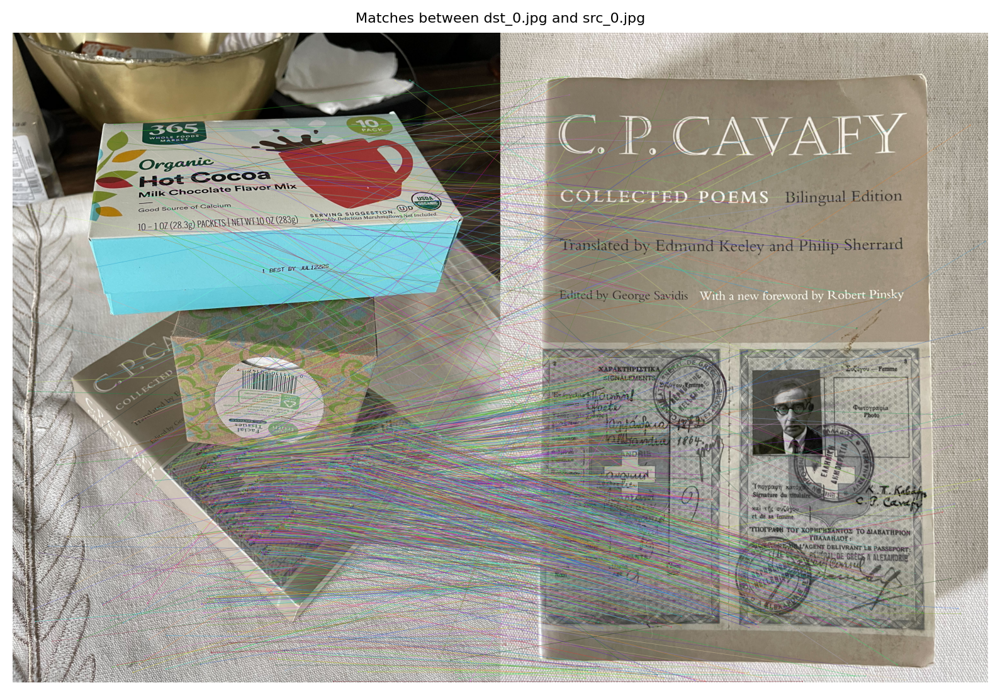

In [19]:
# TODO
# SIFT 
dst_keypoints, dst_descriptors = sift.detectAndCompute(dst_gray, None)
src_keypoints, src_descriptors = sift.detectAndCompute(src_gray, None)

# brute force with L2 norm
bf = cv.BFMatcher(cv.NORM_L2, crossCheck=False)

# find the top 2 matches for each descriptor
matches = bf.knnMatch(dst_descriptors, src_descriptors, k=2)

# ratio test
good_matches = []
for m, n in matches:
    if m.distance < 0.75 * n.distance:
        good_matches.append(m)

# draw the matches
img_matches = cv.drawMatches(dst_img, dst_keypoints, src_img, src_keypoints, good_matches, outImg=None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# visualization
plt.figure(figsize=(10, 8), dpi=200)
plt.imshow(cv.cvtColor(img_matches, cv.COLOR_BGR2RGB))
plt.title('Matches between dst_0.jpg and src_0.jpg', fontsize=8)
plt.axis('off')
plt.show()

## Compute Homography (10 pts)

Compute the homography using RANSAC. Print out the homography matrix. Transform the four corners of the source image using the homography and display the transformed rectangle on the destination image. You can follow the tutorial in https://docs.opencv.org/4.5.2/d1/de0/tutorial_py_feature_homography.html

Homography Matrix:
 [[ 4.88020340e-01  2.93758452e-01  1.36307234e+02]
 [-1.36946037e-01  1.76170759e-01  2.13160365e+03]
 [ 7.32255215e-05 -5.92399465e-05  1.00000000e+00]]


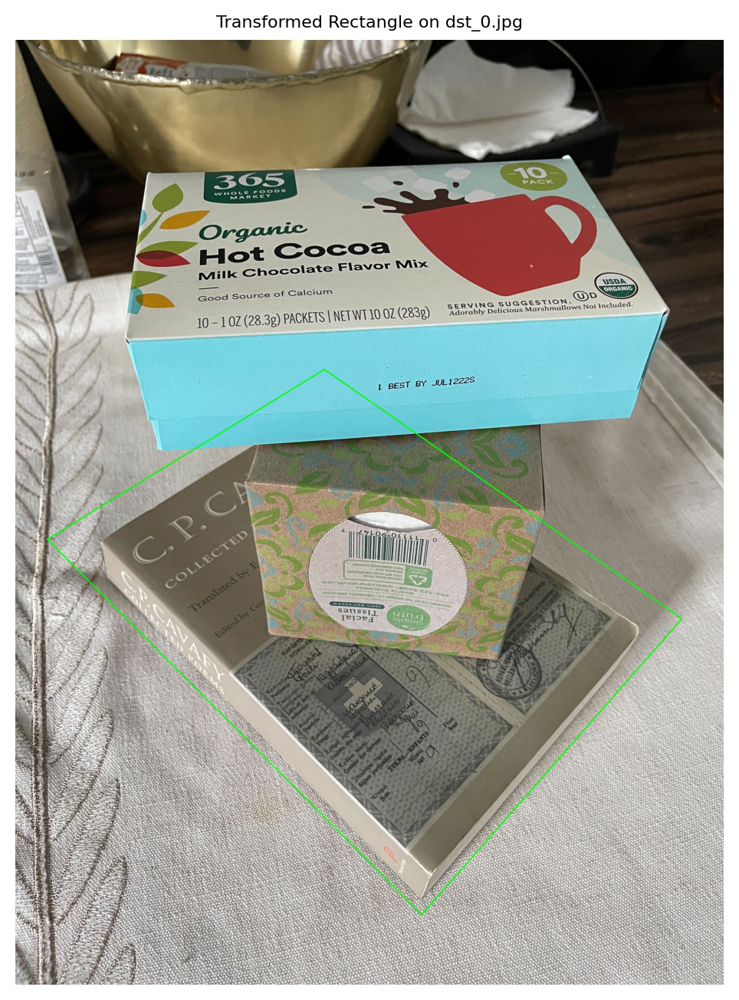

In [20]:
# TODO
# extract location of good matches
points_dst = np.float32([ dst_keypoints[m.queryIdx].pt for m in good_matches ]).reshape(-1,1,2)
points_src = np.float32([ src_keypoints[m.trainIdx].pt for m in good_matches ]).reshape(-1,1,2)

# compute homography
H, _ = cv.findHomography(points_src, points_dst, cv.RANSAC, 5.0)

print("Homography Matrix:\n", H)

# transform the four corners
corners_src = np.float32([[0, 0], [src_img.shape[1] - 1, 0], [src_img.shape[1] - 1, src_img.shape[0] - 1], [0, src_img.shape[0] - 1]]).reshape(-1, 1, 2)
corners_dst = cv.perspectiveTransform(corners_src, H)

# display the transformed rectangle
cv.polylines(dst_img, [np.int32(corners_dst)], isClosed=True, color=(0, 255, 0), thickness=3, lineType=cv.LINE_AA)

plt.figure(figsize=(10, 8), dpi=200)
plt.imshow(cv.cvtColor(dst_img, cv.COLOR_BGR2RGB))
plt.title('Transformed Rectangle on dst_0.jpg', fontsize=8)
plt.axis('off')
plt.show()

## Observation (5 pts)
Write down your observations regarding the results you obtained throughout the `Homography` section.

## **TODO: write down your observations**

The success of matching largely depends on the presence of distinctive features. SIFT is a good choice for feature detection. However, some other algorithms like SURF, Harris, SUSAN, and FAST could be applied. When matching the feature, the brute force matcher is applied. Some other algorithms, like FLANN-based matcher, have faster speed.

After extracting feature points, I'm using the `cv.findHomograph`y with RANSAC strategy to find the homography matrix. An accurate homography should result in the source image aligning well with the destination when it's transformed. 

Based on the result I get, the transformed rectangle in the plot appears to correctly highlight a region in the destination image. It aligns well with the actual boundaries of the source object in the destination image, which means the homography I calculate is accurate.

# Panorama (30 pts)

## Data Preparation
To stitch photos into a panorama, you need to prepare two or more photos of the same scene. There should be enough intersection between two consecutive photos. Again, we provided an example in the folder `panorama`, but we encourage you to take photos with your own camera or smartphone.

## Compute Homography (10 pts)
Here we are computing homography again, but once every two consecutive images. To do this, you need to first import the images. Then you pick a feature detector (not necessarily SIFT) and detect features. Then you pick a feature matcher (not necessarily brute-force) and find matches between every two consecutive images. Then you compute homography and store them. Below we write a skeleton for you, but you needn't follow it.

In [21]:
import numpy as np
import cv2 as cv
import os


# read images
input_path = 'data/panorama/'
# filenames = [input_path + filename for filename in os.listdir(input_path)]
filenames = sorted([input_path + filename for filename in os.listdir(input_path)])
print(filenames)
images = [cv.imread(filename) for filename in filenames]
count = len(images)

homography_matrices = []
images_matches = []

for i in range(count-1):
    # convert to grayscale images
    gray1 = cv.cvtColor(images[i], cv.COLOR_BGR2GRAY)
    gray2 = cv.cvtColor(images[i+1], cv.COLOR_BGR2GRAY)

    # TODO
    # detect and compute descriptors using ORB
    # sift = cv.SIFT_create()
    orb = cv.ORB_create()
    
    keypoints1, descriptors1 = orb.detectAndCompute(gray1, None)
    keypoints2, descriptors2 = orb.detectAndCompute(gray2, None)

    # BFMatcher
    # bf = cv.BFMatcher(cv.NORM_L2, crossCheck=False)
    # matches = bf.knnMatch(descriptors1, descriptors2, k=2)

    # FLANN based matcher
    FLANN_INDEX_LSH = 6
    # FLANN_INDEX_KDTREE = 1
    # index_params = dict(algorithm=FLANN_INDEX_KDTREE, tree=5)
    index_params = dict(algorithm=FLANN_INDEX_LSH, table_number=6, key_size=12, multi_probe_level=1)
    search_params = dict(checks=50)
    
    flann = cv.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(descriptors1, descriptors2, k=2)

    # ratio test
    good_matches = []
    for (m, n) in matches:
        if m.distance < 0.7 * n.distance:
            good_matches.append(m)

    # extract location of good matches
    src_pts = np.float32([keypoints1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([keypoints2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

    # homography
    H, _ = cv.findHomography(src_pts, dst_pts, cv.RANSAC, 5.0)
    homography_matrices.append(H)

    # draw the matches
    img_matches = cv.drawMatches(images[i], keypoints1, images[i+1], keypoints2, good_matches, outImg=None, flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    images_matches.append(img_matches)
    
print(homography_matrices)

['data/panorama/001.jpg', 'data/panorama/002.jpg', 'data/panorama/003.jpg']
[array([[ 1.42382213e+00, -5.61051316e-02, -1.26148691e+03],
       [ 2.07359611e-01,  1.24303512e+00, -5.28566216e+02],
       [ 1.04451604e-04, -4.60827449e-07,  1.00000000e+00]]), array([[ 1.88453372e+00, -6.75519353e-02, -2.04135999e+03],
       [ 3.73054897e-01,  1.48969185e+00, -8.73930631e+02],
       [ 2.16322136e-04, -1.43116605e-05,  1.00000000e+00]])]


## Stitch Panorama (15 pts)
Now we can stitch those images to compose a panorama. You need to select an image as an anchor and transform other images onto this anchor image. The transformation between any image and this anchor image is the composition of a series of homography. You should compute the transformations and map all other images onto the anchor image. You can explore other ways to define an anchor. Then you need to blend these image. A possible way is to just take the maximum of the pixel values, but you are encouraged to explore other blending methods (extra points +2~5 pts). After you obtained your panorama, display it along with some intermediate results including feature matches and transformed images. We attached an example in the folder `panorama_output`. Below we provide the code to compute the size of a rectangle that covers all transformed images, but you needn't follow it.

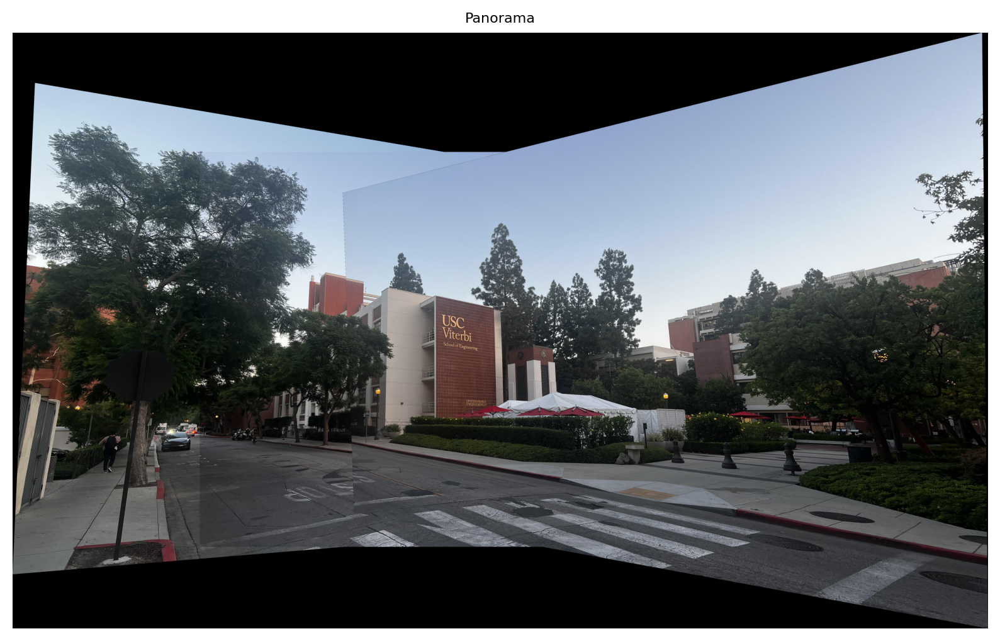

In [32]:
from matplotlib import pyplot as plt
import matplotlib.gridspec as gridspec

# TODO: some processing of the homography matrices
# select the middle image as the anchor image
idx_center = count // 2

cumulative_homographies = [np.eye(3) for _ in range(count)]
for i in range(idx_center-1, -1, -1):
    cumulative_homographies[i] = np.dot(homography_matrices[i], cumulative_homographies[i+1])
for i in range(idx_center, count-1):
    cumulative_homographies[i+1] = np.dot(np.linalg.inv(homography_matrices[i]), cumulative_homographies[i])

min_x = min_y = max_x = max_y = 0.0
for i in range(count):
    # Get the height and width of the original images
    h, w, p = images[i].shape
    # Create a list of points to represent the corners of the images
    corners = np.array([[0, 0], [w, 0], [w, h], [0, h]], dtype=np.float32)
    # Calculate the transformed corners
    transformed_corners = cv.perspectiveTransform(corners.reshape(-1, 1, 2), cumulative_homographies[i])
    # Find the minimum and maximum coordinates to determine the output size
    min_x = min(transformed_corners[:, 0, 0].min(), min_x)
    min_y = min(transformed_corners[:, 0, 1].min(), min_y)
    max_x = max(transformed_corners[:, 0, 0].max(), max_x)
    max_y = max(transformed_corners[:, 0, 1].max(), max_y)

# Calculate the width and height of the stitched image
output_width = int(max_x - min_x)
output_height = int(max_y - min_y)

# TODO: blend the transformed images
panorama = np.zeros((output_height, output_width, 3), dtype=np.uint8)
warped_images = []

for i in range(count):
    # create offset transformation
    offset_x = int(-min_x)
    offset_y = int(-min_y)
    transformation = np.array([[1, 0, offset_x], [0, 1, offset_y], [0, 0, 1]])
    # warp images
    warped = cv.warpPerspective(images[i], np.dot(transformation, cumulative_homographies[i]), (output_width, output_height), flags=cv.INTER_LINEAR, borderMode=cv.BORDER_CONSTANT)
    warped_images.append(warped)
    # create logical mask for warped image and previous panorama
    mask = np.where(warped > 0, 1, 0).astype(np.uint8)
    panorama_mask = np.where(panorama > 0, 1, 0).astype(np.uint8) 
    # alpha blending
    panorama = np.where(mask == 1, warped, panorama)
    alpha = 0.5
    panorama = np.where((mask == 1) & (panorama_mask == 1), (warped * alpha + panorama * (1-alpha)).astype(np.uint8), panorama)

# TODO: display the panorama along with some intermediate results
fig = plt.figure(figsize=(10, 8), dpi=200)

plt.imshow(cv.cvtColor(panorama, cv.COLOR_BGR2RGB))
plt.title("Panorama", fontsize=8)
plt.axis('off')

plt.show()

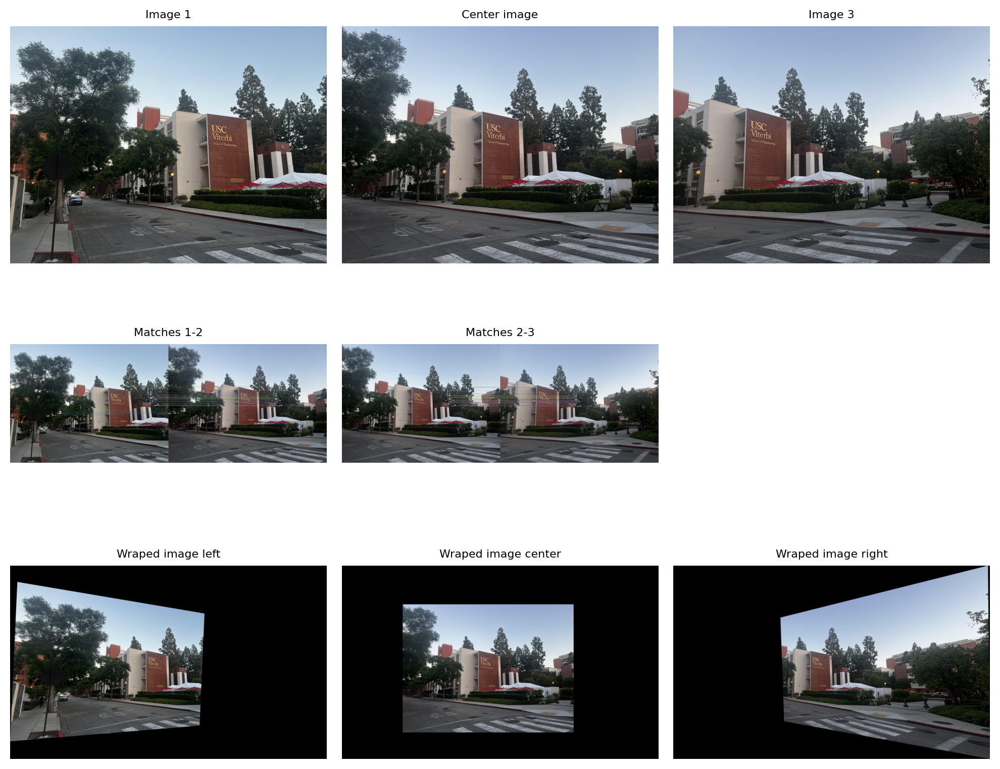

In [35]:
gs = gridspec.GridSpec(3, 3)
fig = plt.figure(figsize=(10, 8), dpi=200)

ax1 = fig.add_subplot(gs[0, 0])
ax1.imshow(cv.cvtColor(images[0], cv.COLOR_BGR2RGB))  
ax1.set_title("Image 1", fontsize=8)
ax1.axis('off')

ax2 = fig.add_subplot(gs[0, 1])
ax2.imshow(cv.cvtColor(images[1], cv.COLOR_BGR2RGB))  # Show middle image as a sample
ax2.set_title("Center image", fontsize=8)
ax2.axis('off')

ax3 = fig.add_subplot(gs[0, 2])
ax3.imshow(cv.cvtColor(images[2], cv.COLOR_BGR2RGB)) 
ax3.set_title("Image 3", fontsize=8)
ax3.axis('off')

# matches
ax4 = fig.add_subplot(gs[1, 0])
ax4.imshow(cv.cvtColor(images_matches[0], cv.COLOR_BGR2RGB))
ax4.set_title("Matches 1-2", fontsize=8)
ax4.axis('off')

ax5 = fig.add_subplot(gs[1, 1])
ax5.imshow(cv.cvtColor(images_matches[1], cv.COLOR_BGR2RGB))
ax5.set_title("Matches 2-3", fontsize=8)
ax5.axis('off')

ax6 = fig.add_subplot(gs[2, 0])
ax6.imshow(cv.cvtColor(warped_images[0], cv.COLOR_BGR2RGB))
ax6.set_title("Wraped image left", fontsize=8)
ax6.axis('off')

ax7 = fig.add_subplot(gs[2, 1])
ax7.imshow(cv.cvtColor(warped_images[1], cv.COLOR_BGR2RGB))
ax7.set_title("Wraped image center", fontsize=8)
ax7.axis('off')

ax8 = fig.add_subplot(gs[2, 2])
ax8.imshow(cv.cvtColor(warped_images[2], cv.COLOR_BGR2RGB))
ax8.set_title("Wraped image right", fontsize=8)
ax8.axis('off')

plt.tight_layout()
plt.show()

## Observation (5 pts)
Write down your observations regarding the results you obtained throughout the `Panorama` section.

## **TODO: write down your observations**

As discussed before, I changed the keypoint detection algorithms from SIFT to ORB, and used FLANN-based matcher, which is faster (takes only 2 sec).

I encountered some problems when creating a cumulative matrix. Before, I calculated the matrix from 1-2, 2-3. This would make the 1st image as the based image. Actually, I should set the 2nd image as the center image and calculate from 2-3 and 2-1.

I chose to use alpha blending. Utilizing logical mask for warped image and previous panorama, I achieve the blending operation. Instead of directly taking the maximum pixel value between overlapping images, this can create smoother transitions. By simply adjusting the parameter `alpha`, the algorithm can achieve a better frontier.

The provided panorama image shows that a recognizable and mostly coherent panorama was achieved.